### Import Libs

In [292]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import plotly.graph_objects as go
import seaborn as sns
from plotly.subplots import make_subplots
from math import ceil
from copy import deepcopy

### Read and format data

In [293]:
PATH_PART_2 = '../data/part 2'

In [294]:
df_assets = pd.read_csv(PATH_PART_2+'/assets.csv')
df_assets.head()

,_id,company,createdAt,description,model,modelType,name,sensors,specifications.axisX,specifications.axisY,specifications.axisZ,specifications.maxDowntime,specifications.maxTemp,specifications.power,specifications.rpm,specifications.workdays
0,602fac7228aba1048d473cc4,5fb2c4eb1369a4325dc4545f,2021-02-19T12:17:54.457Z,NaN,60241102ed8ef30e9d309af9,compressor,Ventilador Acima do Elemento GA160 FF - Prédio...,"[""IAJ9206""]",vertical,horizontal,axial,48.00,NaN,3.7,1735.0,NaN
1,5fd0e297bf7d581c1823b8e4,5fbbadeb82a6b901c26df618,2020-12-09T14:43:35.168Z,NaN,5fd0cf96bf7d581c1823b4c4,heaterFurnace,RDF-61.1,"[""LZY4270""]",axial,vertical,horizontal,0.25,55.0,0.0,1740.0,NaN
2,5fb286de1369a4325dc45433,5f6b83e34dd69d4bc799ea1f,2020-11-16T14:04:14.564Z,-,5fb275981369a4325dc4542e,transformer,TRANSFORMADOR 500 KVA N°1,"[""MUR8453""]",horizontal,vertical,NaN,NaN,65.0,NaN,NaN,NaN
3,6023fad9ed8ef30e9d30952b,5fb2c4eb1369a4325dc4545f,2021-02-10T15:25:13.265Z,NaN,6023f7dced8ef30e9d30945f,pump,Motor Bomba - Tanque de Expansão Tubo Verde,"[""MXK6435""]",horizontal,axial,vertical,48.00,NaN,7.0,3525.0,NaN
4,5ff71a150b6abb7be05083b0,5f17203f640a00cc08cb1b3d,2021-01-07T14:26:29.726Z,NaN,5ff5a854adacd8372cf06950,pump,CAG1- BAGS.12- Motor,"[""MYD8706""]",horizontal,axial,vertical,NaN,NaN,30.0,1765.0,NaN


In [295]:
df_assets['sensors'] = df_assets['sensors'].apply(lambda x:x[2:-2])

In [296]:
df_assets.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 16 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   _id                         10 non-null     object 
 1   company                     10 non-null     object 
 2   createdAt                   10 non-null     object 
 3   description                 3 non-null      object 
 4   model                       10 non-null     object 
 5   modelType                   10 non-null     object 
 6   name                        10 non-null     object 
 7   sensors                     10 non-null     object 
 8   specifications.axisX        8 non-null      object 
 9   specifications.axisY        8 non-null      object 
 10  specifications.axisZ        7 non-null      object 
 11  specifications.maxDowntime  6 non-null      float64
 12  specifications.maxTemp      5 non-null      float64
 13  specifications.power        8 non-null

In [297]:
df_collects = pd.read_csv(PATH_PART_2+'/collects.csv')
df_collects.head(10)

,_id,createdAt,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.sampRate,params.timeStart,params.velRMS.x,params.velRMS.y,params.velRMS.z,sensorId,temp
0,60b57955f77013684c413e39,2021-06-01T00:03:33.370Z,0.010463,0.004463,0.011677,3.006,1656.686627,1.622506e+09,0.000511,0.000176,0.000289,IAJ9206,23.94
1,60b57c53f77013684c41409f,2021-06-01T00:16:19.173Z,0.011437,0.004983,0.011482,3.006,1656.686627,1.622507e+09,0.000633,0.000238,0.000292,IAJ9206,23.19
2,60b57f34f77013684c4142cd,2021-06-01T00:28:36.553Z,0.010494,0.005024,0.011120,3.006,1656.686627,1.622507e+09,0.000524,0.000226,0.000246,IAJ9206,22.50
3,60b58237f77013684c41450c,2021-06-01T00:41:27.622Z,0.009859,0.004786,0.011096,3.006,1656.686627,1.622508e+09,0.000437,0.000220,0.000248,IAJ9206,22.87
4,60b58515f77013684c414765,2021-06-01T00:53:41.450Z,0.010014,0.005213,0.011332,3.006,1656.686627,1.622509e+09,0.000501,0.000251,0.000275,IAJ9206,22.56
5,60b587f2f77013684c414987,2021-06-01T01:05:54.307Z,0.010951,0.004751,0.011504,3.006,1656.686627,1.622510e+09,0.000580,0.000230,0.000304,IAJ9206,21.81
6,60b58ad6f77013684c414be4,2021-06-01T01:18:14.468Z,0.011001,0.004790,0.011696,3.006,1656.686627,1.622510e+09,0.000593,0.000222,0.000306,IAJ9206,21.87
7,60b58dc1f77013684c414e42,2021-06-01T01:30:41.688Z,0.010492,0.005010,0.011517,3.006,1656.686627,1.622511e+09,0.000556,0.000238,0.000282,IAJ9206,21.50
8,60b590bdf77013684c4150a1,2021-06-01T01:43:25.520Z,0.010417,0.004966,0.011568,3.006,1656.686627,1.622512e+09,0.000519,0.000220,0.000258,IAJ9206,21.37
9,60b593aaf77013684c4152f4,2021-06-01T01:55:54.302Z,0.010061,0.005315,0.011435,3.006,1656.686627,1.622513e+09,0.000487,0.000255,0.000286,IAJ9206,21.19


In [298]:
df_collects.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33901 entries, 0 to 33900
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   _id                33901 non-null  object 
 1   createdAt          33901 non-null  object 
 2   params.accelRMS.x  33441 non-null  float64
 3   params.accelRMS.y  33441 non-null  float64
 4   params.accelRMS.z  33441 non-null  float64
 5   params.duration    33441 non-null  float64
 6   params.sampRate    33441 non-null  float64
 7   params.timeStart   33441 non-null  float64
 8   params.velRMS.x    33441 non-null  float64
 9   params.velRMS.y    33441 non-null  float64
 10  params.velRMS.z    33441 non-null  float64
 11  sensorId           33901 non-null  object 
 12  temp               33901 non-null  float64
dtypes: float64(10), object(3)
memory usage: 3.4+ MB


In [299]:
df_collects['createdAt'] = pd.to_datetime(df_collects['createdAt'])
df_collects = df_collects.sort_values(by=['sensorId', 'createdAt'])
df_collects.set_index('createdAt', inplace=True)

In [300]:
df_collects.head()

,_id,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.duration,params.sampRate,params.timeStart,params.velRMS.x,params.velRMS.y,params.velRMS.z,sensorId,temp
createdAt,,,,,,,,,,,,
2021-06-01 00:03:33.370000+00:00,60b57955f77013684c413e39,0.010463,0.004463,0.011677,3.006,1656.686627,1.622506e+09,0.000511,0.000176,0.000289,IAJ9206,23.94
2021-06-01 00:16:19.173000+00:00,60b57c53f77013684c41409f,0.011437,0.004983,0.011482,3.006,1656.686627,1.622507e+09,0.000633,0.000238,0.000292,IAJ9206,23.19
2021-06-01 00:28:36.553000+00:00,60b57f34f77013684c4142cd,0.010494,0.005024,0.011120,3.006,1656.686627,1.622507e+09,0.000524,0.000226,0.000246,IAJ9206,22.50
2021-06-01 00:41:27.622000+00:00,60b58237f77013684c41450c,0.009859,0.004786,0.011096,3.006,1656.686627,1.622508e+09,0.000437,0.000220,0.000248,IAJ9206,22.87
2021-06-01 00:53:41.450000+00:00,60b58515f77013684c414765,0.010014,0.005213,0.011332,3.006,1656.686627,1.622509e+09,0.000501,0.000251,0.000275,IAJ9206,22.56


### Data visualization

In [301]:
df_collects['sensorId'].unique()

array(['IAJ9206', 'LZY4270', 'MUR8453', 'MXK6435', 'MYD8706', 'MYS2071',
       'MZU6388', 'NAH4736', 'NAI1549', 'NEW4797'], dtype=object)

In [302]:
not_sensors = ['params.duration', 'params.sampRate', 'params.timeStart']
sensor_columns = df_collects.select_dtypes(include=np.number).columns.tolist()
sensor_columns = [columns for columns in sensor_columns if columns not in not_sensors]

In [303]:
def plot_asset_info(df:pd.DataFrame, sensor:str):
    
    asset = df_assets[df_assets['sensors']==sensor]['name'].values[0]
    model_type = df_assets[df_assets['sensors']==sensor]['modelType'].values[0]
    power = df_assets[df_assets['sensors']==sensor]['specifications.power'].values[0]
    rpm = df_assets[df_assets['sensors']==sensor]['specifications.rpm'].values[0]
    max_temp = df_assets[df_assets['sensors']==sensor]['specifications.maxTemp'].values[0]
    max_downtime = df_assets[df_assets['sensors']==sensor]['specifications.maxDowntime'].values[0]
    
    num_rows = len(sensor_columns)
    fig = make_subplots(rows=num_rows, cols=1,  subplot_titles=[column for column in sensor_columns], vertical_spacing=0.3/num_rows)

    for i, column in enumerate(sensor_columns):  
        fig.add_trace(go.Scatter(x=df.index, 
                                 y=df[column], 
                                 mode='lines',
                                 line={
                                     'width':1.75
                                 }), row=i+1, col=1)

        fig.update_xaxes(title_text='Time', row=i+1, col=1)
        fig.update_yaxes(title_text=column, row=i+1, col=1)

    fig.update_layout(
        title=f"""
                Ativo: {asset} <br>Sensor: {sensor}<br>Tipo: {model_type}<br>Potência: {power}<br>RPM: {rpm}<br>Temperatura máxima: {max_temp}<br>Tempo de downtime: {max_downtime}
               """,
        height=400*num_rows+400,
        width=1400,
        margin=dict(t=250),
        showlegend=False
    )
    fig.update_layout(
        title=dict(y=0.98,  xanchor='left', yanchor='top'))
    fig.show()

In [304]:
for sensor in df_collects['sensorId'].unique():
    df = df_collects[df_collects['sensorId']==sensor]
    plot_asset_info(df, sensor)

### Uptime and downtime

I chose the sensor MYD8706 for this analysis

In [305]:
sensor = 'MYD8706'
df = df_collects[df_collects['sensorId']==sensor]
df = df[sensor_columns]
df.isna().sum()

params.accelRMS.x    64
params.accelRMS.y    64
params.accelRMS.z    64
params.velRMS.x      64
params.velRMS.y      64
params.velRMS.z      64
temp                  0
dtype: int64

In [306]:
df = df.interpolate()
df.isna().sum()

params.accelRMS.x    0
params.accelRMS.y    0
params.accelRMS.z    0
params.velRMS.x      0
params.velRMS.y      0
params.velRMS.z      0
temp                 0
dtype: int64

In [307]:
plot_asset_info(df, sensor)

In [308]:
df.describe()

,params.accelRMS.x,params.accelRMS.y,params.accelRMS.z,params.velRMS.x,params.velRMS.y,params.velRMS.z,temp
count,4354.000000,4354.000000,4354.000000,4354.000000,4354.000000,4354.000000,4354.000000
mean,0.107181,0.083955,0.091677,0.001530,0.001265,0.000884,23.424421
std,0.119075,0.096034,0.093721,0.001523,0.001355,0.000520,6.152071
min,0.008405,0.004325,0.013520,0.000171,0.000091,0.000287,9.750000
25%,0.009133,0.004882,0.015020,0.000292,0.000157,0.000458,18.190000
50%,0.009225,0.004990,0.015466,0.000299,0.000161,0.000469,23.690000
75%,0.245668,0.197085,0.201656,0.003301,0.002876,0.001485,27.870000
max,0.321101,0.229714,0.259092,0.012329,0.004618,0.001806,41.940000


In [309]:
def plot_distribution(df, n_cols=4, hue=None):
        
    n_rows = int(ceil(df.shape[1]/n_cols))
    fig = plt.figure(figsize=(16, n_rows*4))
    for idx, column in enumerate(df.columns):
        ax = plt.subplot(n_rows, n_cols, idx+1)
        sns.kdeplot(data=df, x=column, fill=True, common_norm=True, ax=ax, hue=hue)
        ax.set_title(column)
        ax.grid()
        
    fig.tight_layout()
    plt.show()

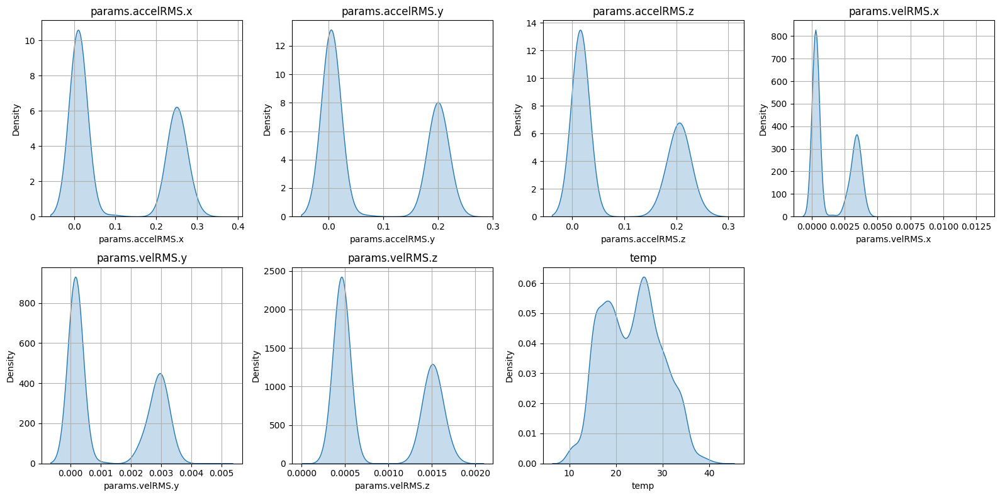

In [310]:
plot_distribution(df)

As we can see, there is a clear difference of behavior of this asset, representing the downtime and uptime.

In [311]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, dbscan
from sklearn.metrics import silhouette_score

In [312]:
df.columns

Index(['params.accelRMS.x', 'params.accelRMS.y', 'params.accelRMS.z',
       'params.velRMS.x', 'params.velRMS.y', 'params.velRMS.z', 'temp'],
      dtype='object')

In [313]:
scaler = StandardScaler()
X = scaler.fit_transform(df)

In [314]:
kmeans_model = KMeans(n_clusters=2)
labels = kmeans_model.fit_predict(X)

In [315]:
df['label'] = labels

In [316]:
df['label'].value_counts()

label
0    2603
1    1751
Name: count, dtype: int64

In [317]:
aux_column = df.columns[0] # Get info of a column
labels_list = df['label'].unique()
mean_list = []
for label in df['label'].unique():
    mean = df[df['label']==label][aux_column].mean()
    mean_list.append(mean)

uptime_label = labels_list[np.argmax(mean_list)]
downtime_label = labels_list[np.argmin(mean_list)]

In [318]:
def plot_clustering_result(df:pd.DataFrame, sensor:str):
    
    num_rows = len(sensor_columns)
    fig = make_subplots(rows=num_rows, cols=1,  subplot_titles=[column for column in sensor_columns], vertical_spacing=0.3/num_rows)
    
    df_uptime = deepcopy(df)
    df_downtime = deepcopy(df)
    df_uptime.loc[df_uptime['label']==downtime_label , sensor_columns] = np.nan
    df_downtime.loc[df_downtime['label']==uptime_label , sensor_columns] = np.nan

    for i, column in enumerate(sensor_columns):  
        
        fig.add_trace(go.Scatter(x=df_downtime.index,
                                 y=df_downtime[column],
                                 mode='lines+markers',
                                 name = 'downtime',
                                 legendgroup=i,
                                 marker={
                                     'color':'red',
                                     'size':4.5
                                 },
                                 ), row=i+1, col=1)
        fig.add_trace(go.Scatter(x=df_uptime.index,
                                 y=df_uptime[column],
                                 mode='lines+markers',
                                 name = 'uptime',
                                 legendgroup=i,
                                 marker={
                                     'color':'green',
                                     'size':4.5
                                 },
                                 ), row=i+1, col=1)

        fig.update_xaxes(title_text='Time', row=i+1, col=1)
        fig.update_yaxes(title_text=column, row=i+1, col=1)
        fig.update_layout(showlegend=True)

    fig.update_layout(
        title=sensor,
        height=400*num_rows,
        width=1600,
        legend_tracegroupgap = 350
    )
    fig.show()

In [319]:
plot_clustering_result(df, sensor)

C:\Users\anton\AppData\Local\Temp\ipykernel_24988\3824319794.py:7: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



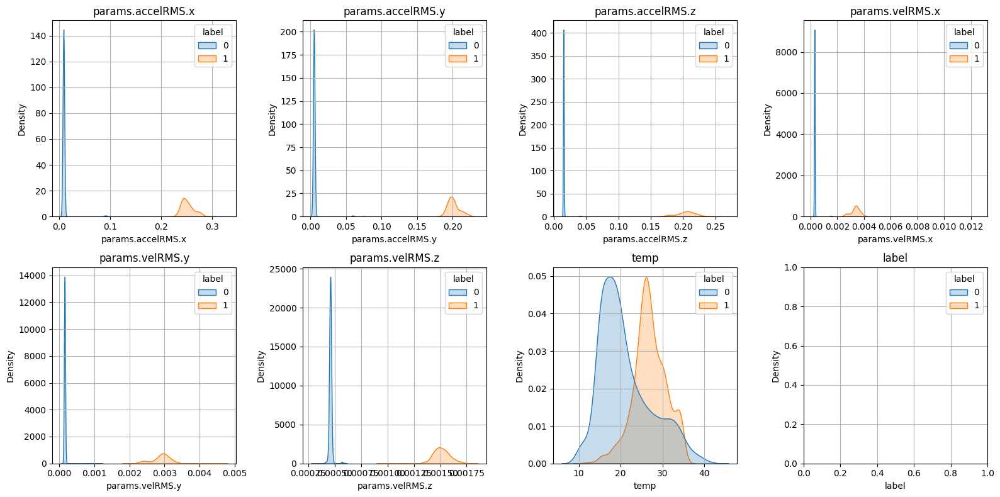

In [320]:
plot_distribution(df, hue='label')

In [321]:
df_aux = deepcopy(df)
df_aux['aux'] = (df_aux['label'].diff() != 0).astype('int').cumsum()
df_aux['date'] = df_aux.index

df_down_up_time = pd.DataFrame({'start_date' : df_aux.groupby('aux')['date'].min(), 
                                'final_date' : df_aux.groupby('aux')['date'].max(),
                                'consecutive_calues' : df_aux.groupby('aux').size(), 
                                'label':df_aux.groupby('aux')['label'].first()
                                }).reset_index(drop=True)
df_down_up_time.head()

,start_date,final_date,consecutive_calues,label
0,2021-06-01 00:07:16.967000+00:00,2021-06-01 12:48:37.713000+00:00,65,0
1,2021-06-01 13:00:20.660000+00:00,2021-06-02 00:20:04.950000+00:00,58,1
2,2021-06-02 00:32:04.585000+00:00,2021-06-02 12:25:30.212000+00:00,61,0
3,2021-06-02 12:37:44.633000+00:00,2021-06-03 00:07:00.573000+00:00,59,1
4,2021-06-03 00:19:01.484000+00:00,2021-06-03 13:00:36.322000+00:00,65,0


In [322]:
# Calculate duration of interval in hours
df_down_up_time['duration'] = (df_down_up_time['final_date'] - df_down_up_time['start_date']).apply(lambda x:round(x.total_seconds()/3600,3))

In [325]:
uptime = df_down_up_time[df_down_up_time['label']==uptime_label]['duration'].sum()
downtime = df_down_up_time[df_down_up_time['label']==downtime_label]['duration'].sum()

In [326]:
print(f'The uptime of this asset is: {round(uptime,2)} hours')
print(f'The downtime of this asset is: {round(downtime,2)} hours')

The uptime of this asset is: 341.14 hours
The downtime of this asset is: 509.58 hours
